## So....What actually is a TIFF file anyway?

TIFF stands for Tag Image File Format, a format for storing raster graphic images. It was designed to establish a general consensus on a common scanned image file format.

 
### TIFF Header

The header of a TIFF file contains things like the TIFF version and where to find the first Image File Directory in the file. 

 ### Image File Directories and Data

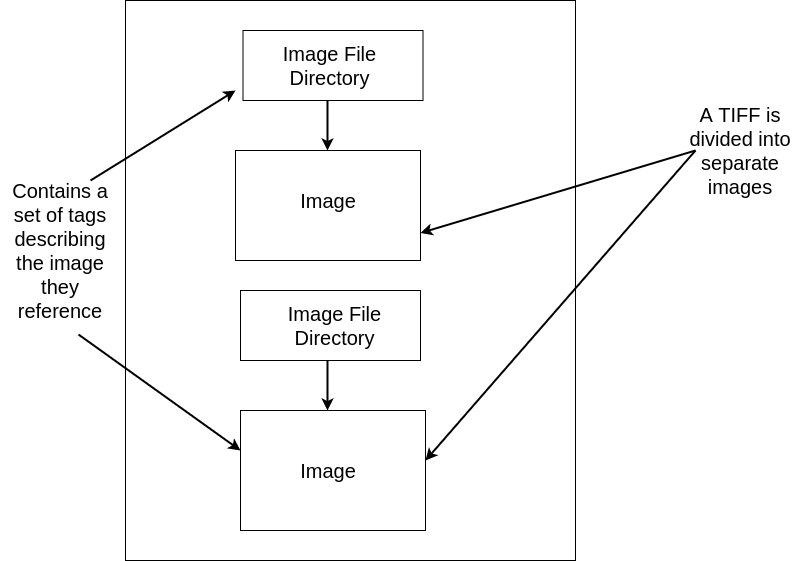

---

## What Makes a GeoTIFF Different?

A GeoTIFF file has some additional tags containing information about where the image exists on earth. his includes things like map projections, coordinate systems, datums, etc. Basically lots of interesting geodspatial relevant info that provides a spatial reference.

---

## What is a Cloud Optimized GeoTIFF, and why is it important?

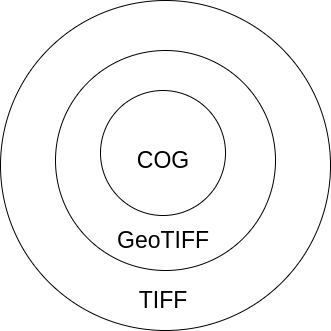

A cloud optimized GeoTiff, or COG, is a type of GeoTIFF file that has been formatted to work on the cloud. So why is this format so important?

## The Why

 ### - Analyze Problems on a Global Scale

 ### - Handle Exponential Growth of Data

 ### - Allow Efficient Streaming of Data - Reduce Data Duplication

### - Democratizing Data Science - Make Geospatial Data More Accessible and Available

---

## The How

Cloud Optimized GeoTIFFs are the gold standard format for storing raster data in cloud storage. Why? Well, it comes down to how the format is structured internally. COGs fundamentally depend on technology that work in conjunction with each other. The manner in which pixels are organized (internal tiling, overviews, compression) makes it easier for users to access parts of the data corresponding to their particular area of interest, without needing to download the entire file first. 

 ## Organization

 ### Internal Tiling

In a COG, pixels are stored in tiles. This creates the ability to access just the part of a file that is needed because all relevant information is stored together in each tile. 

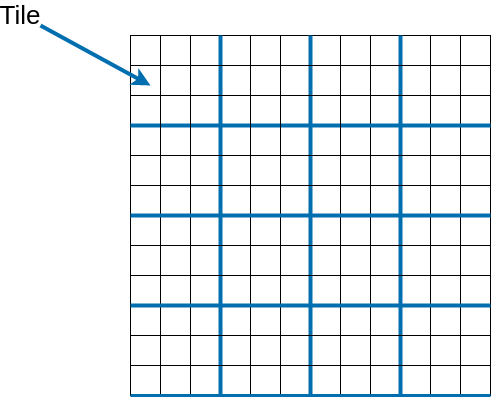

 ### Overviews

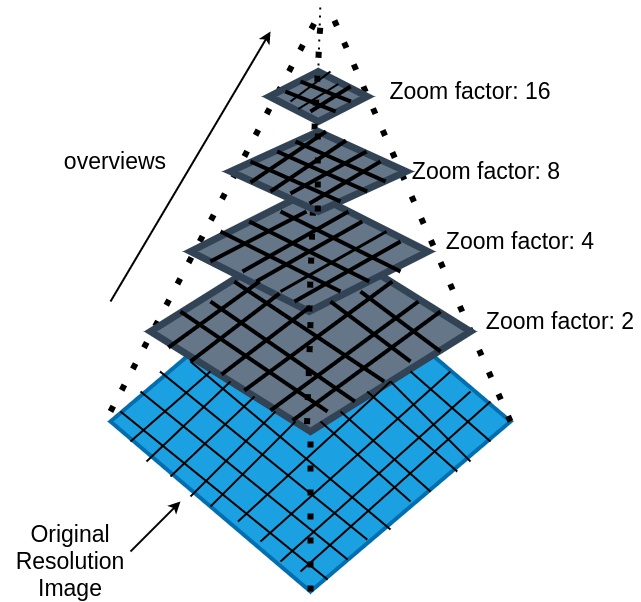

Overviews form zoomed out, or lower resolution, versions of the original image. This is what is refered to as <b>downsampling</b>. You increase the size of the cells in the grid, making the image smaller and have less detail. A GeoTIFF file will often have multiple overviews, each with a different zoom level

Overviews are really useful when a client wants to quickly render an image of the whole file. This can be done very efficiently because the client doesn't need to request the original resolution image, but can instead request one of the overviews that are available to obtain a quick preview of the image very fast. 

---

### Visualizing Overviews Using Rasterio

Here we will visualize the overviews of the blue, green, and red bands of two sample COGs with an AOI centered around midtown Manhattan. The first COG is a PSScene4Band analytic image. The second COG is a PSOrthoTile visual image. 

In [1]:
import rasterio
import os
import matplotlib.pyplot as plt
from rasterio.plot import show
import numpy as np
%matplotlib inline

In [17]:
def generate_overviews(image):
    with rasterio.open(image) as src:   
        
        # Iterate over the blue, green, and red bands 
         for band in src.indexes[:-1]:  
                
            # Get list of overview levels for the band
            cog_overview = src.overviews(band)
            
            # Iterate over each level in reverse order 
            for i in range(len(cog_overview)-1, -1, -1):
                
                overview_image = src.read(band, out_shape=(int(src.height/cog_overview[i]), int(src.width/cog_overview[i])))
                # Apply a boolean mask to convert all 0 values in the array to nan
                overview_image = overview_image.astype(float)
                overview_image[np.where(overview_image==0)] = np.nan
            
                # Plot each overview
                plt.figure(figsize=(20, 15))
                plt.xlabel("Columns", fontsize=20)
                plt.ylabel("Rows", fontsize=20)
                plt.title('Overview: Band: {} -- Zoom Level {} -- Modified height: {}, Modified Width: {}'.format(band, cog_overview[i], overview_image.shape[0], overview_image.shape[1]), fontsize=20)
                plt.imshow(overview_image)
                plt.show()

In [18]:
# Can replace with any sample COG of your choosing
analytic_image = os.getcwd() + '/20210514_145807_70_2455_3B_AnalyticMS.tif'
visual_image = os.getcwd() + '/'+ '4478803_1857818_2021-05-14_227b_RGB_Visual.tif'

Let's take a look at the analytic image. For each band, we are taking a decimated read of the image at the different overviews, or zoom factors(often seen in factors of 2). We can see the image transition from from a quite detailed view to a progressively coarser, less refined resolution. The visual effects become most noticeable at the highest overview level.

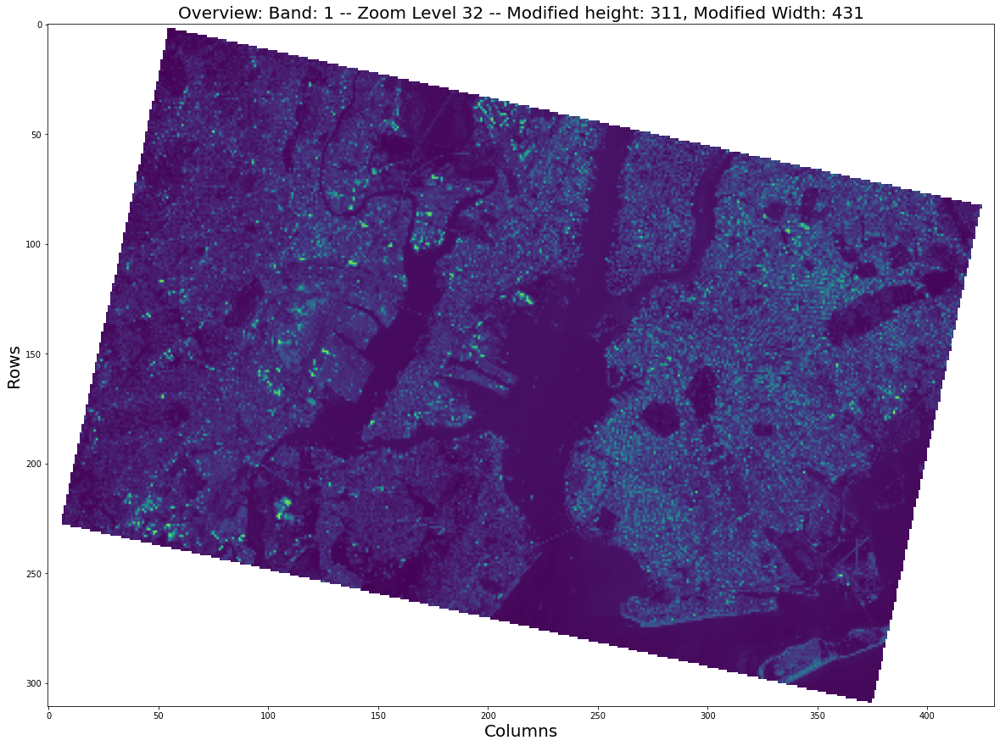

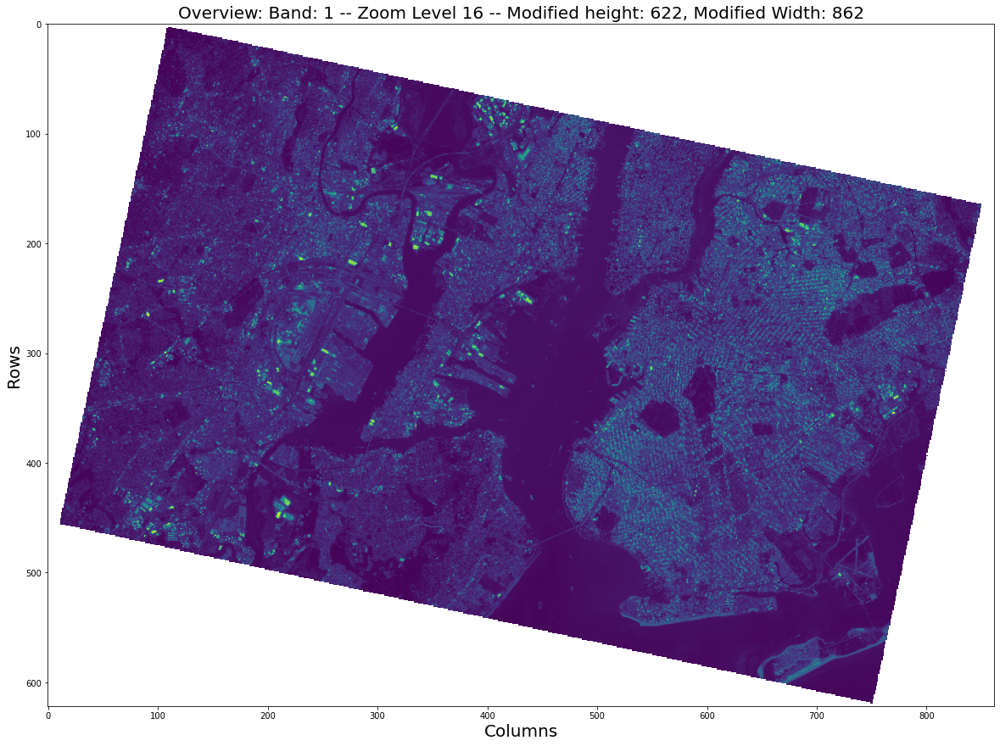

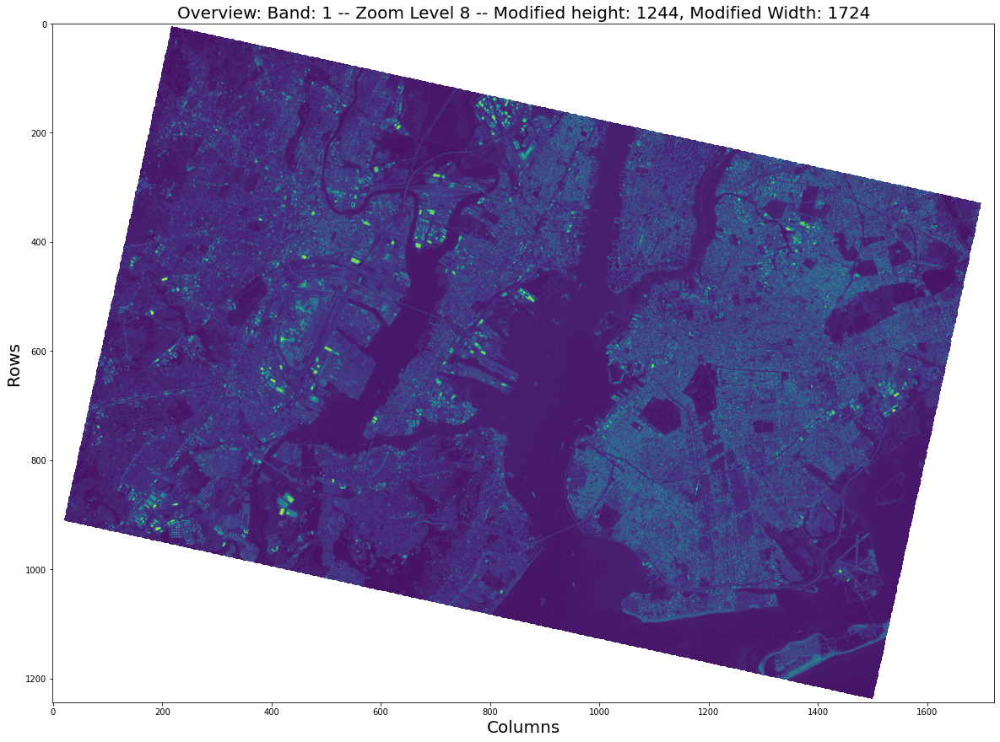

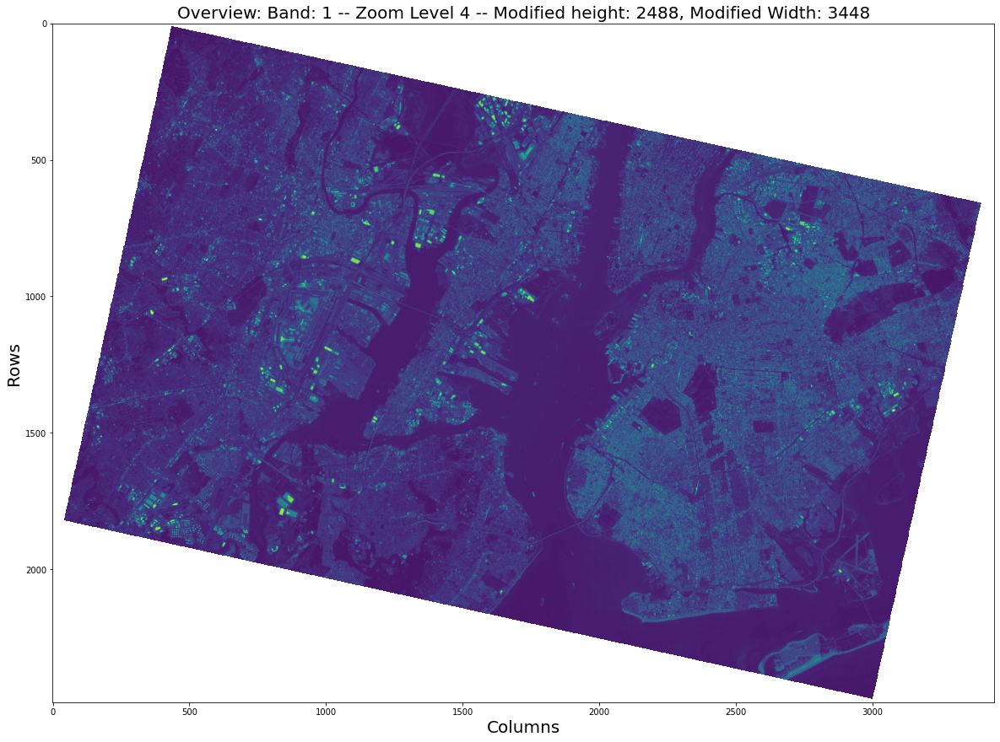

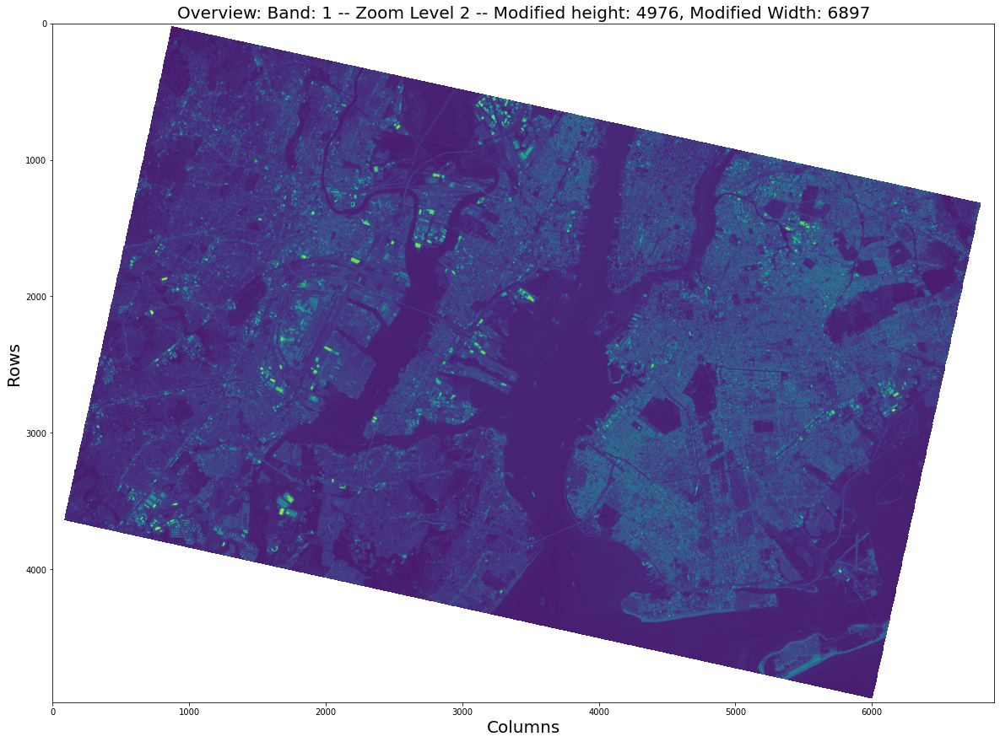

...

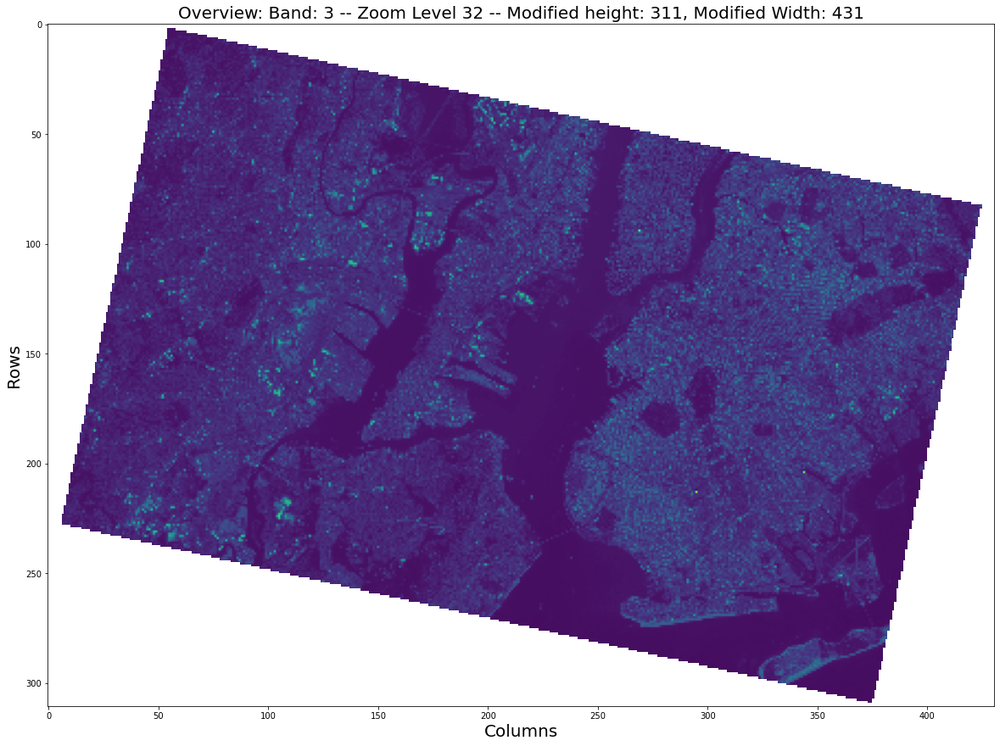

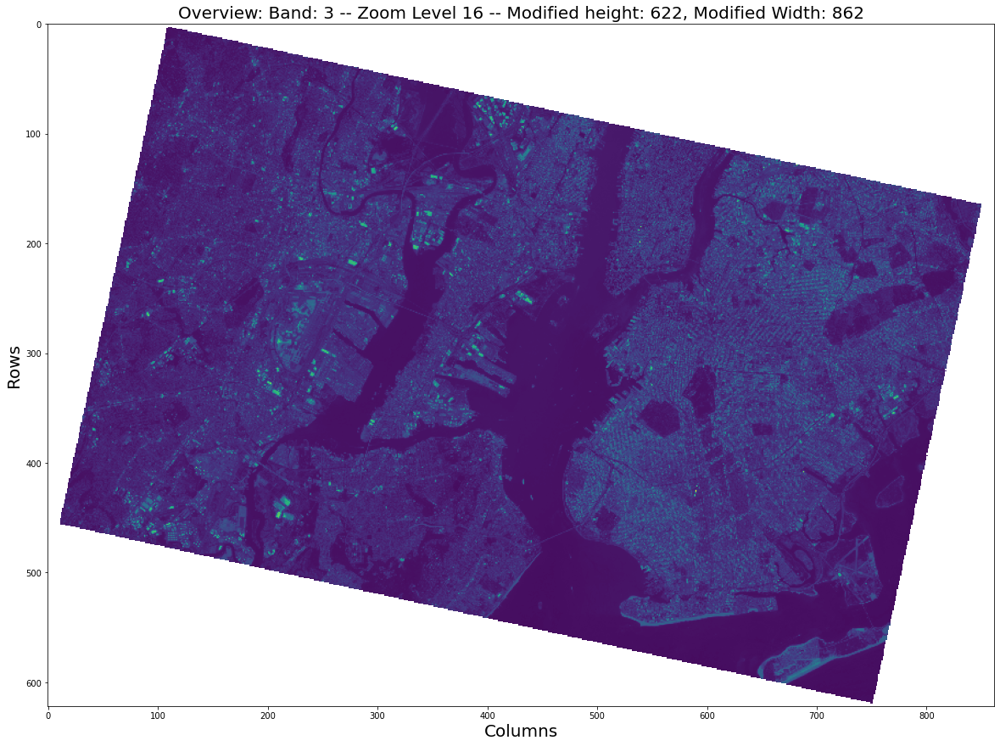

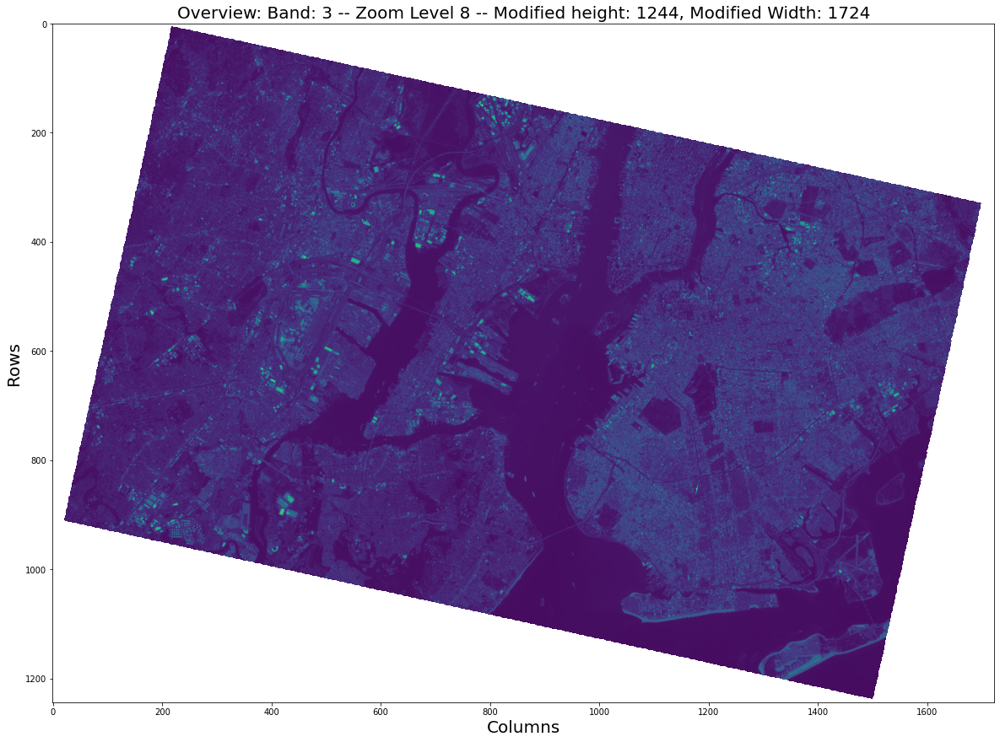

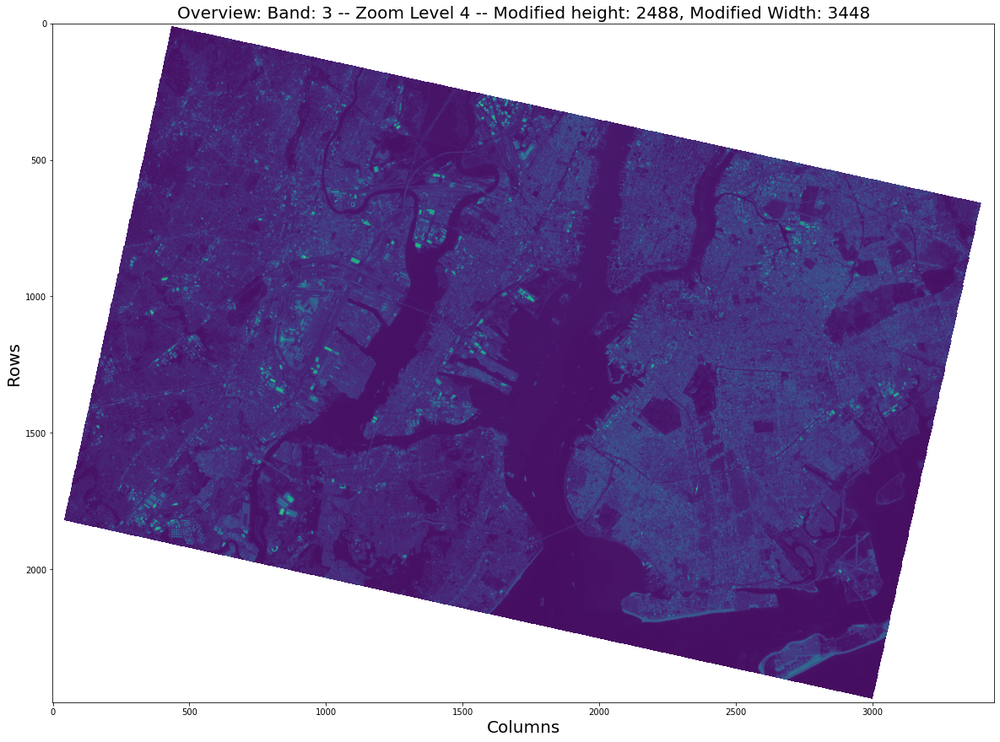

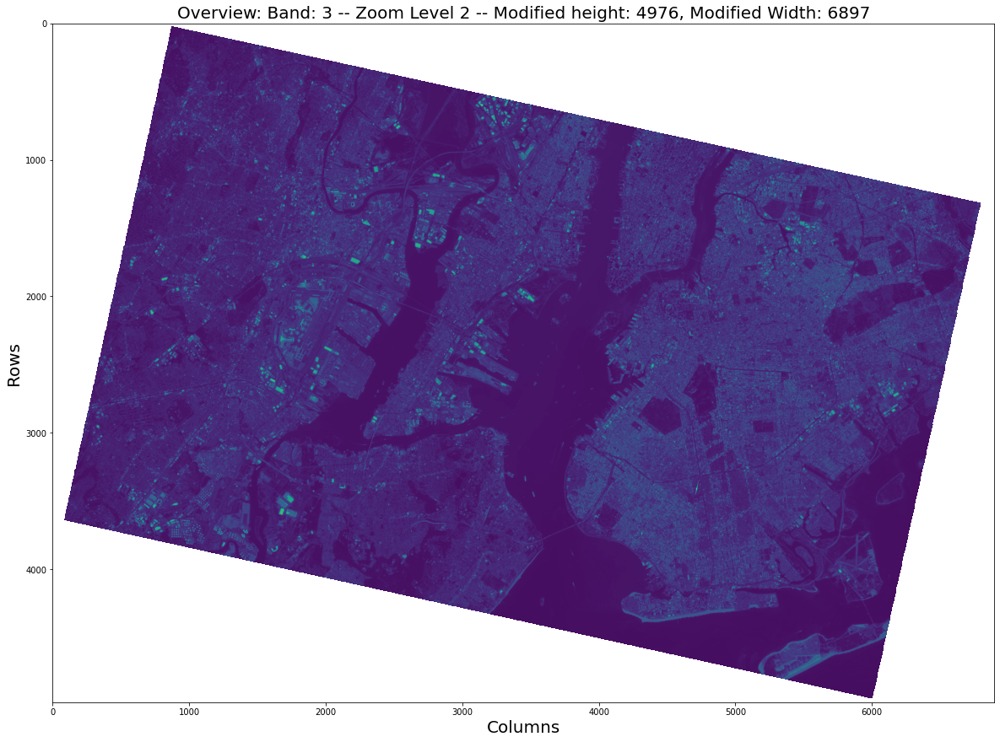

In [19]:
overviews = generate_overviews(analytic_image)

Now let's look at the visual image.As you take a decimated read of the image at each overview (in this case factors of 3), you can really notice the difference in resolution as you increase the zoom levels.

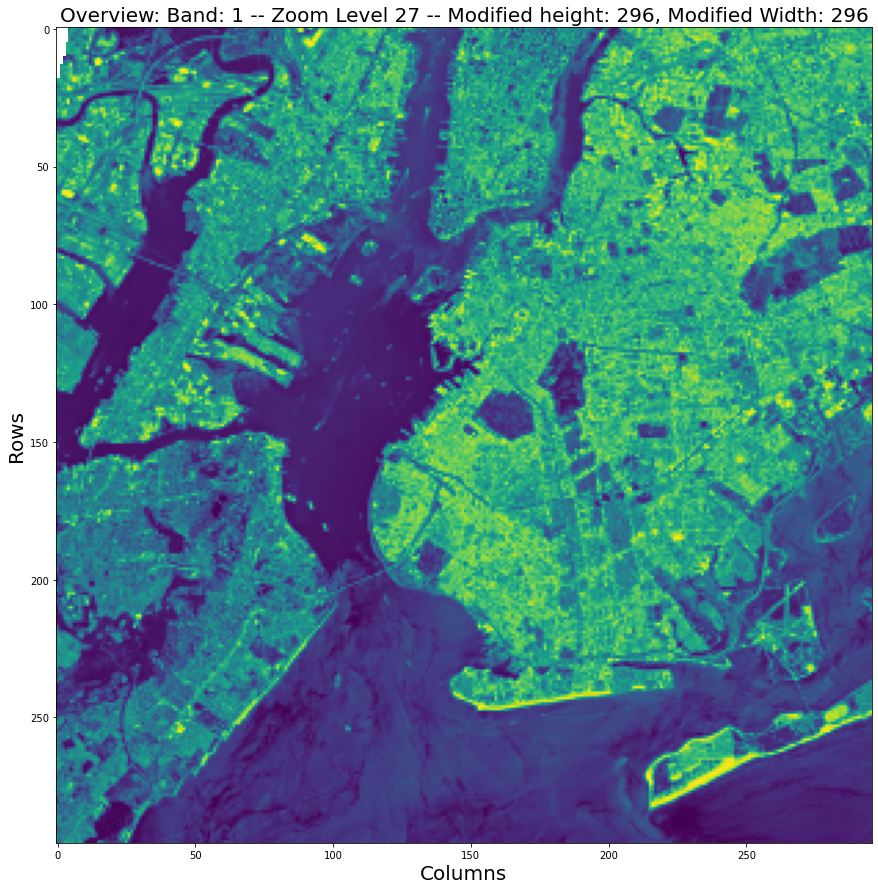

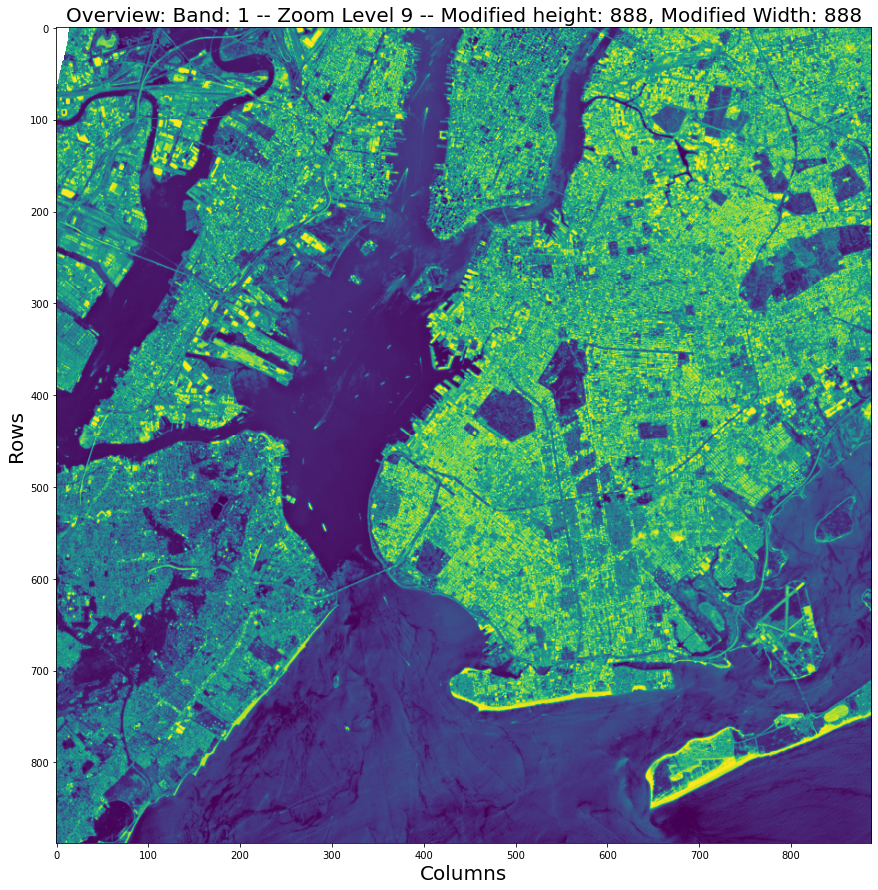

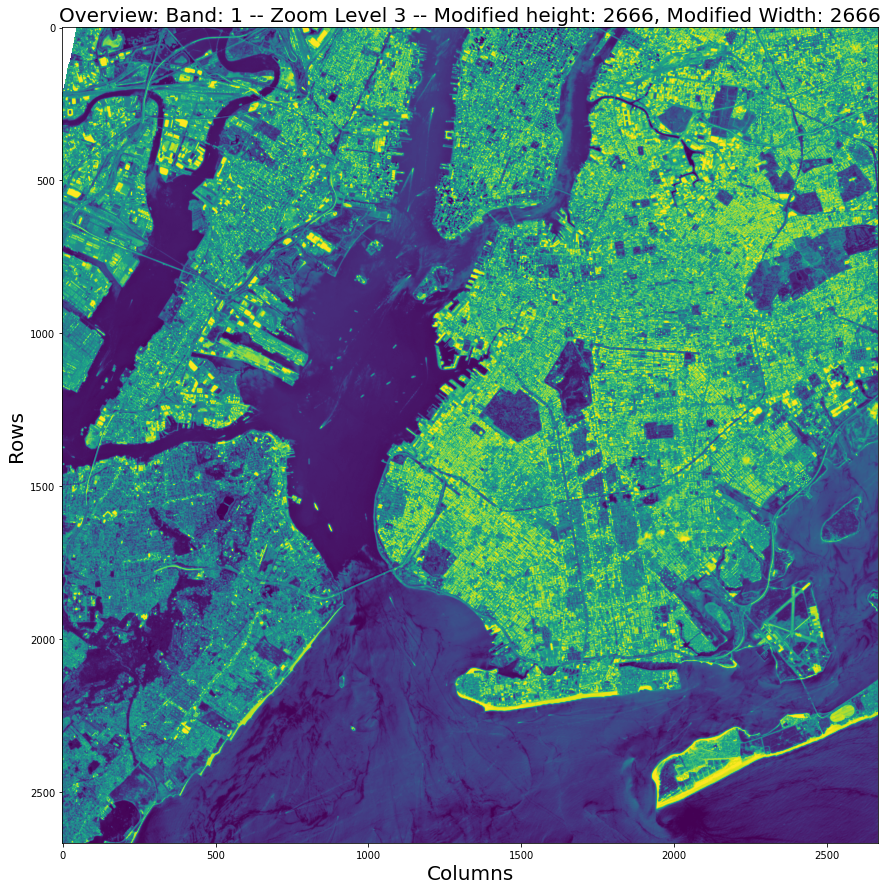

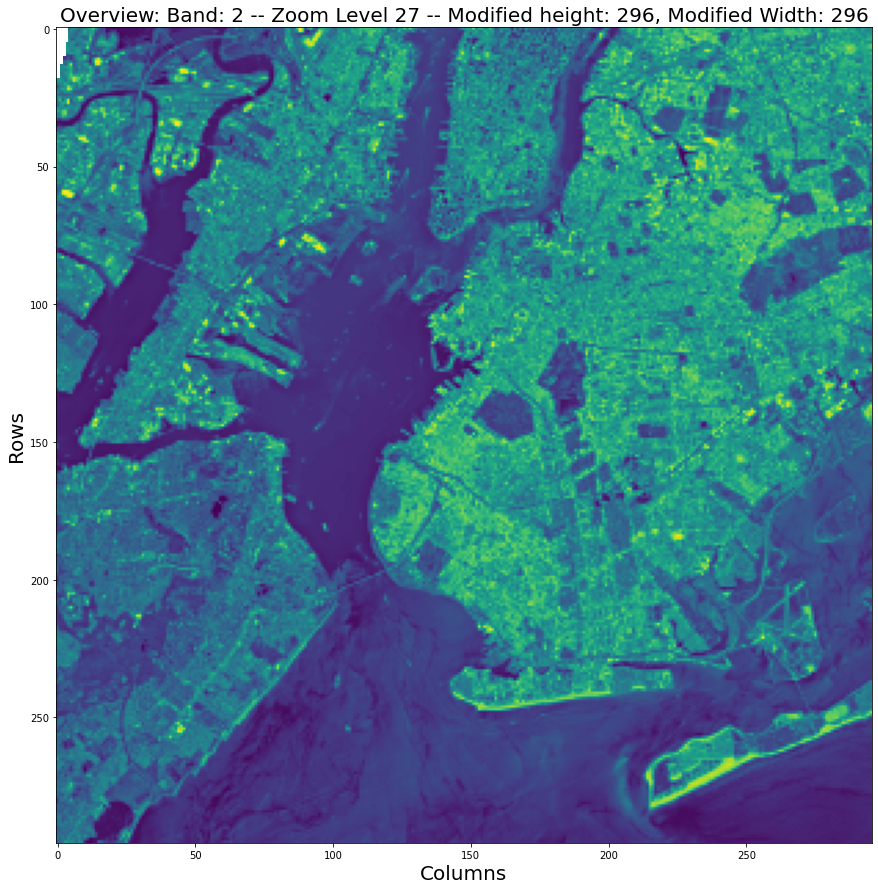

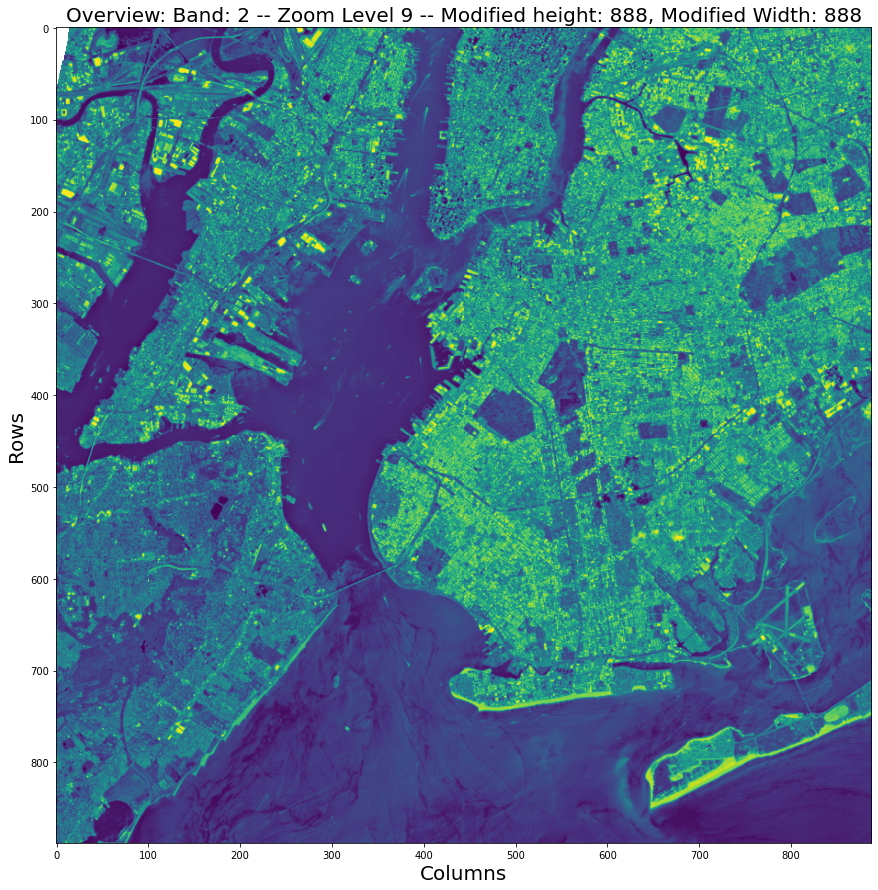

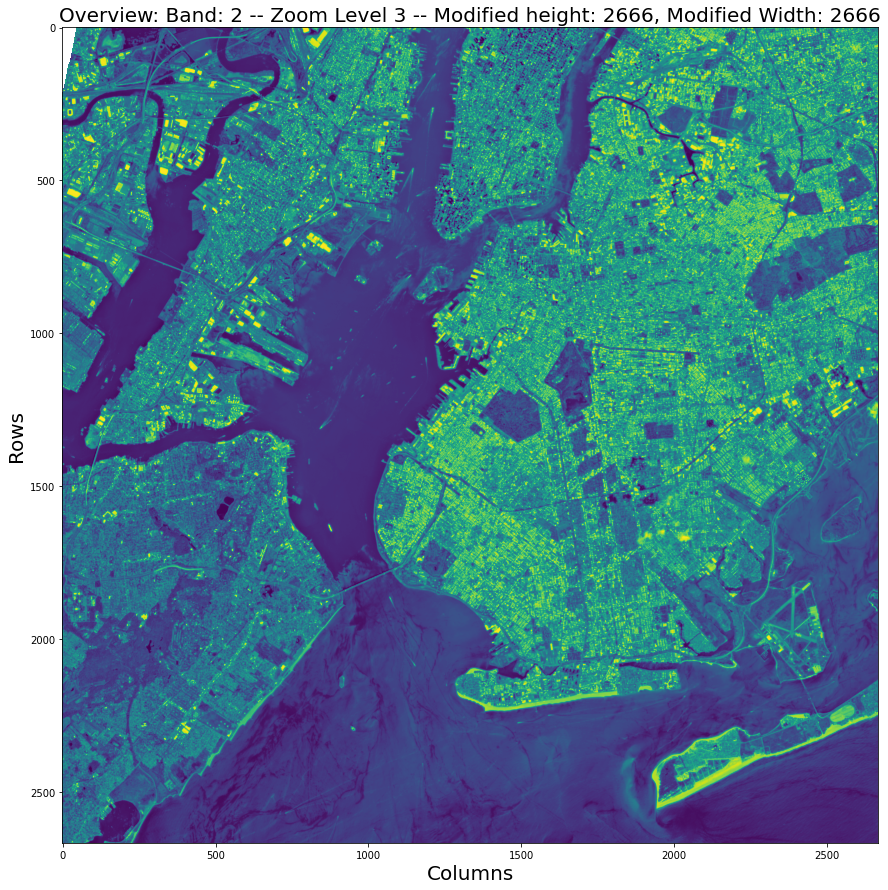

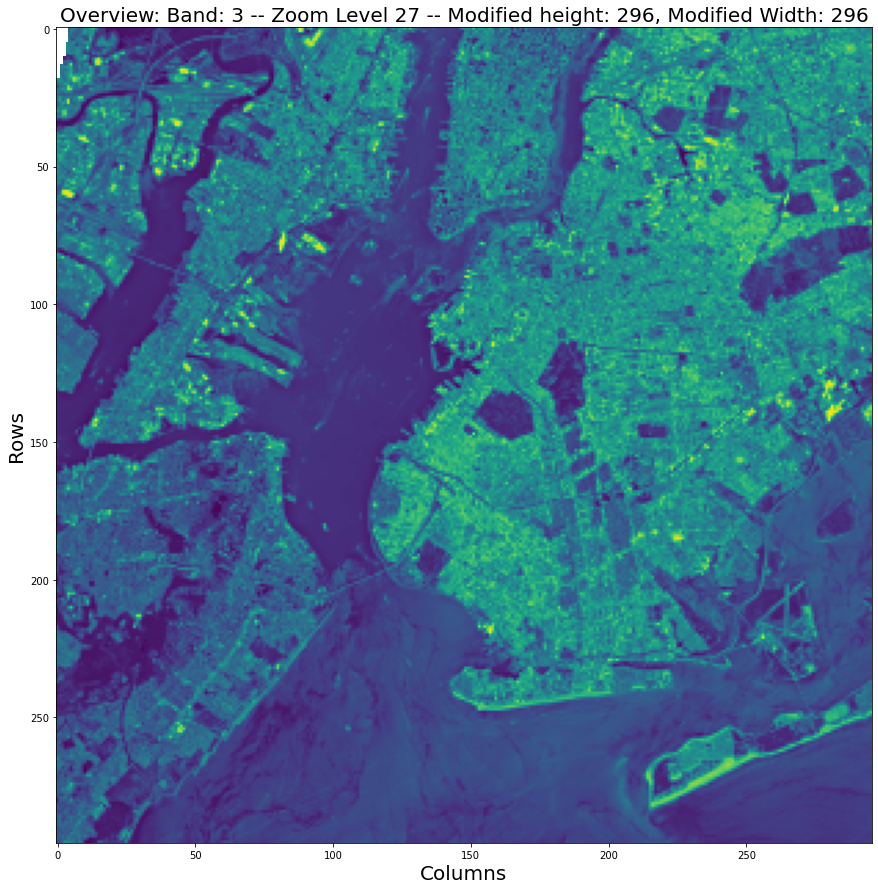

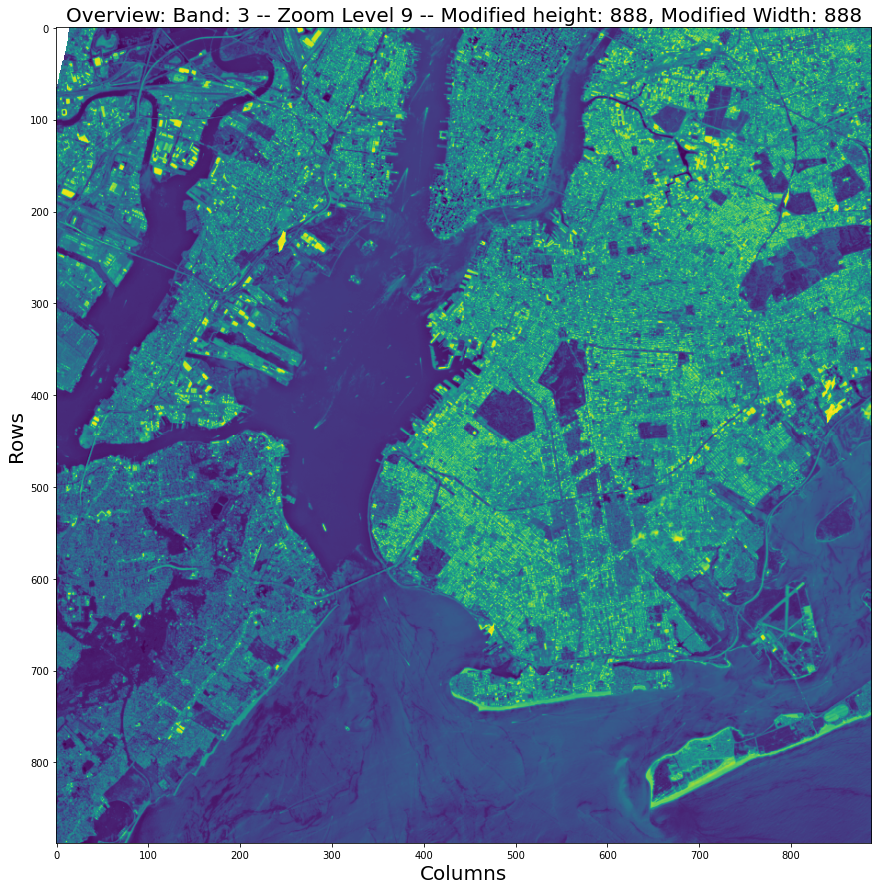

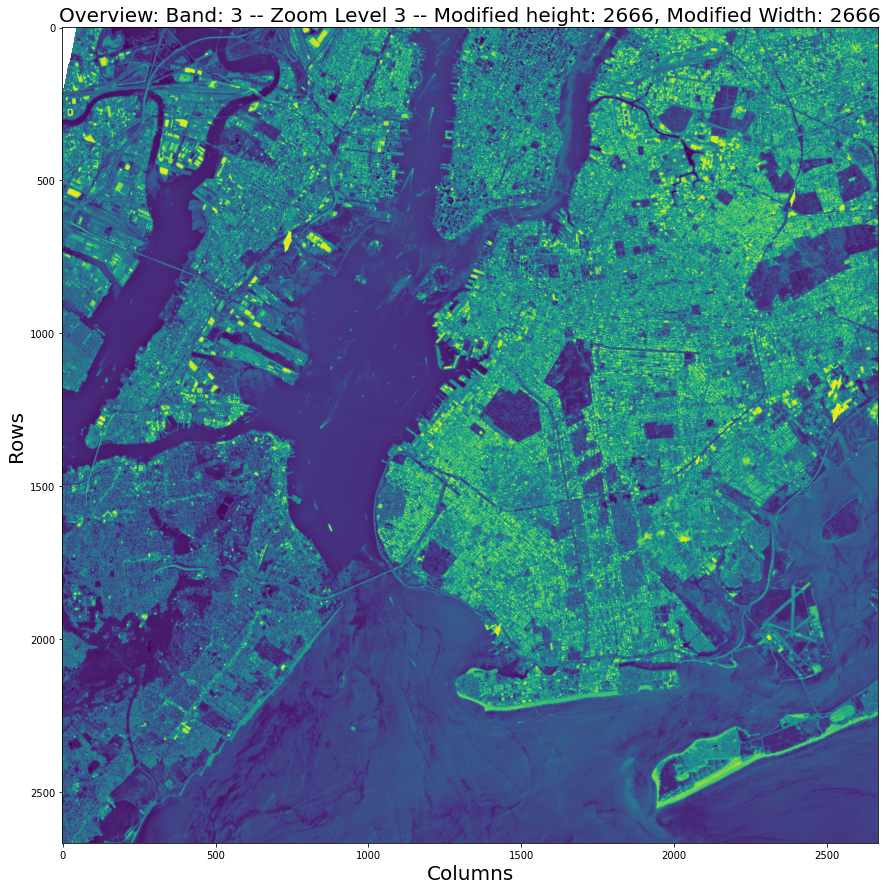

In [20]:
overviews = generate_overviews(visual_image)
overviews

---

## Overall COG Structure

The diagrams presented below contrast how the IFDs and the actual data they reference are mapped out in the memory of the file. This is an important distinction between a normal GeoTIFF and a COG. In a regular GeoTIFF, the locations of where things can be stored is pretty fluid. However, for a COG to be a COG, the IFDs are structured at the beginning of the file, acting essentially as a very useful table of contents. 

For a COG, the IFDs are very important because they contain information about the tile offsets and tile byte counts for every tile. So because the IFDs are stored at the very beginning of file and contain information on the offset and byte count of each tile, you are able to quickly get a mapping of where each tile begins in the file, as well as its size. By knowing where each tile is located in the file, you are able toquickly get just the parts of the file you need. 

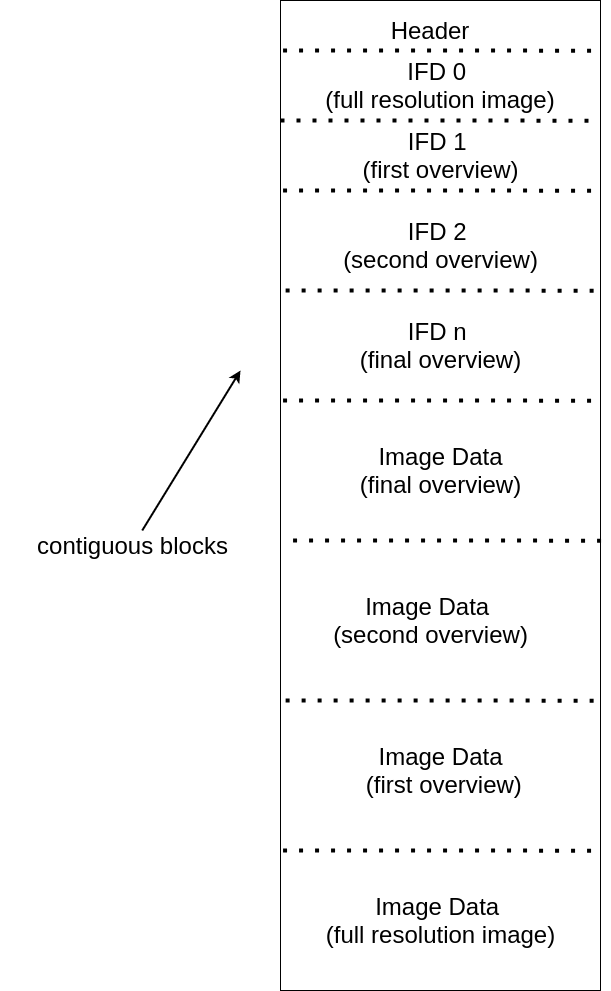

## Ordinary TIFF/GeoTIFF Structure

Here we can see that the IFDs are scattered throughout the file and not at the beginning like a COG as illustrated above. 

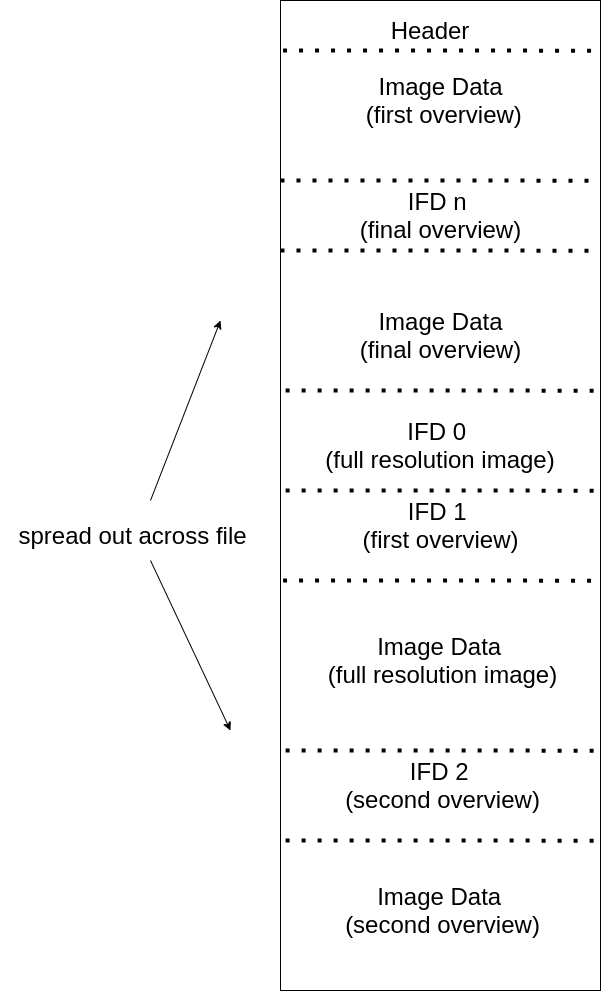

---

 ## HTTP GET Range Request

The organizational features mentioned above go hand in hand when a client is making a GET request to a server. If the server has an <b>Accept Range: Bytes</b> in its response header, clients can specify a range of bytes when making a request, getting only the parts of the data, in this case the TIFF file, that they actually need rather than needing to wait for the entire file to finish downloading.

The overviews make it possible to preview the image quickly by reducing the amount of range requests made. You only need to get the values from the overview rather than all of the pixels from the raw image. 

This is why if you look at a COG compared to a regular GeoTIFF in a tool like cogeo, the performance difference is notable. With the COG, you'll be able to load the image faster and zoom in and out much smoother than you would if you were working with a regular GeoTIFF. With the GeoTIFF, the entire image needs to finish downloading before the tiles can be generated for viewing.

---

## Next Steps

In the next tutorial, we will use Planet's Data API and Orders API to download some Regular GeoTIFFs and show how to convert them into COGs!